# Ford Go Bike Dataset
## by Japheth Rutoh

## Introduction
> The data used in this analysis contains bike-sharing data that covers the San Francisco Bay Area. The dataset contains information for the month of February of the year 2019.





## Preliminary Wrangling


In [191]:
# import required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
sns.set()

import warnings
warnings.simplefilter('ignore')

%matplotlib inline

> Loading the dataset

In [2]:
df = pd.read_csv('data/fordgobike-tripdata.csv')

In [3]:
print(df.shape)
print(df.info())
df.head()

(183412, 16)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183412 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   duration_sec             183412 non-null  int64  
 1   start_time               183412 non-null  object 
 2   end_time                 183412 non-null  object 
 3   start_station_id         183215 non-null  float64
 4   start_station_name       183215 non-null  object 
 5   start_station_latitude   183412 non-null  float64
 6   start_station_longitude  183412 non-null  float64
 7   end_station_id           183215 non-null  float64
 8   end_station_name         183215 non-null  object 
 9   end_station_latitude     183412 non-null  float64
 10  end_station_longitude    183412 non-null  float64
 11  bike_id                  183412 non-null  int64  
 12  user_type                183412 non-null  object 
 13  member_birth_year        175147 non-null  floa

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip
0,52185,2019-02-28 17:32:10.1450,2019-03-01 08:01:55.9750,21.0,Montgomery St BART Station (Market St at 2nd St),37.789625,-122.400811,13.0,Commercial St at Montgomery St,37.794231,-122.402923,4902,Customer,1984.0,Male,No
1,42521,2019-02-28 18:53:21.7890,2019-03-01 06:42:03.0560,23.0,The Embarcadero at Steuart St,37.791464,-122.391034,81.0,Berry St at 4th St,37.775880,-122.393170,2535,Customer,NaN,NaN,No
2,61854,2019-02-28 12:13:13.2180,2019-03-01 05:24:08.1460,86.0,Market St at Dolores St,37.769305,-122.426826,3.0,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,5905,Customer,1972.0,Male,No
3,36490,2019-02-28 17:54:26.0100,2019-03-01 04:02:36.8420,375.0,Grove St at Masonic Ave,37.774836,-122.446546,70.0,Central Ave at Fell St,37.773311,-122.444293,6638,Subscriber,1989.0,Other,No
4,1585,2019-02-28 23:54:18.5490,2019-03-01 00:20:44.0740,7.0,Frank H Ogawa Plaza,37.804562,-122.271738,222.0,10th Ave at E 15th St,37.792714,-122.248780,4898,Subscriber,1974.0,Male,Yes


In [4]:
# statistics for the dataset
df.describe()

,duration_sec,start_station_id,start_station_latitude,start_station_longitude,end_station_id,end_station_latitude,end_station_longitude,bike_id,member_birth_year
count,183412.000000,183215.000000,183412.000000,183412.000000,183215.000000,183412.000000,183412.000000,183412.000000,175147.000000
mean,726.078435,138.590427,37.771223,-122.352664,136.249123,37.771427,-122.352250,4472.906375,1984.806437
std,1794.389780,111.778864,0.099581,0.117097,111.515131,0.099490,0.116673,1664.383394,10.116689
min,61.000000,3.000000,37.317298,-122.453704,3.000000,37.317298,-122.453704,11.000000,1878.000000
25%,325.000000,47.000000,37.770083,-122.412408,44.000000,37.770407,-122.411726,3777.000000,1980.000000
50%,514.000000,104.000000,37.780760,-122.398285,100.000000,37.781010,-122.398279,4958.000000,1987.000000
75%,796.000000,239.000000,37.797280,-122.286533,235.000000,37.797320,-122.288045,5502.000000,1992.000000
max,85444.000000,398.000000,37.880222,-121.874119,398.000000,37.880222,-121.874119,6645.000000,2001.000000


In [5]:
# check for missing values
df.isna().sum()

duration_sec                  0
start_time                    0
end_time                      0
start_station_id            197
start_station_name          197
start_station_latitude        0
start_station_longitude       0
end_station_id              197
end_station_name            197
end_station_latitude          0
end_station_longitude         0
bike_id                       0
user_type                     0
member_birth_year          8265
member_gender              8265
bike_share_for_all_trip       0
dtype: int64

In [6]:
# check what percentage of the data is missing
df.isna().sum()/df.isna().count() * 100

duration_sec               0.000000
start_time                 0.000000
end_time                   0.000000
start_station_id           0.107408
start_station_name         0.107408
start_station_latitude     0.000000
start_station_longitude    0.000000
end_station_id             0.107408
end_station_name           0.107408
end_station_latitude       0.000000
end_station_longitude      0.000000
bike_id                    0.000000
user_type                  0.000000
member_birth_year          4.506248
member_gender              4.506248
bike_share_for_all_trip    0.000000
dtype: float64

> There are missing values in the useful features, but we can afford to drop them as they make up a very small percentage of the dataset.
>
> There are also features that we won't be using for our analysis and those too will be dropped.

### Fix missing values and incorrect data types.

In [7]:
df.columns

Index(['duration_sec', 'start_time', 'end_time', 'start_station_id',
       'start_station_name', 'start_station_latitude',
       'start_station_longitude', 'end_station_id', 'end_station_name',
       'end_station_latitude', 'end_station_longitude', 'bike_id', 'user_type',
       'member_birth_year', 'member_gender', 'bike_share_for_all_trip'],
      dtype='object')

In [8]:
# drop columns not useful for our analysis
cols_to_drop = ['end_time', 'start_station_id','start_station_name', 'start_station_latitude',
                'start_station_longitude', 'end_station_id', 'end_station_name',
                'end_station_latitude', 'end_station_longitude', 'bike_id']
df.drop(cols_to_drop,axis='columns',inplace=True)

In [9]:
# drop nan values in the 'member_birth_year' and 'member_gender' columns
df.dropna(inplace=True)

In [10]:
# check if there are any more missing values
df.isna().sum()

duration_sec               0
start_time                 0
user_type                  0
member_birth_year          0
member_gender              0
bike_share_for_all_trip    0
dtype: int64

> There are data types that are not correct and require fixing.

> These are:
> - <code>start_time</code> as 'datetime'
> - <code>member_birth_year</code> as 'int'
> - <code>user_type,member_gender,bike_share_for_all_trip</code> as categorical

In [11]:
# fix the incorrect data types
df.user_type = df.user_type.astype('category')
df.member_gender = df.member_gender.astype('category')
df.bike_share_for_all_trip =df.bike_share_for_all_trip.astype('category')
df.member_birth_year = df.member_birth_year.astype('int64')

# change start_time to datetime
df.start_time = df.start_time.astype('datetime64')

In [12]:
# test 
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 175147 entries, 0 to 183411
Data columns (total 6 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             175147 non-null  int64         
 1   start_time               175147 non-null  datetime64[ns]
 2   user_type                175147 non-null  category      
 3   member_birth_year        175147 non-null  int64         
 4   member_gender            175147 non-null  category      
 5   bike_share_for_all_trip  175147 non-null  category      
dtypes: category(3), datetime64[ns](1), int64(2)
memory usage: 5.8 MB


In [13]:
# make a copy of the data
ford_bike = df.copy()

> Now we have a few categorical variables and a few numerical values for our analysis.
> We will also extract a few more features from the <code>start_time</code> feature.

### What is the structure of your dataset ?
> The original dataset had <code>(183412,16)</code> rows and columns, but after preliminary wrangling, we are left with <code>(175147,6)</code> rows and columns.
They are <code>'duration_sec', 'start_time', 'user_type', 'member_birth_year', 'member_gender', 'bike_share_for_all_trip'</code>.

### What is the main feature(s) of interest in your dataset?

> The main feature of the dataset is the <code>duration_sec</code> which is the total duration in seconds, of a bike ride. It will be the main focus for our analysis.

### What features in the dataset do you think will help support your investigation into your feature(s) of interest?

> The following features will help support the investigation of duration:
> - <code>user_type</code>
> - <code>member_gender</code>
> - <code>start_time</code>
> - <code>bike_share_for_all_trip</code>
>
>  From the <code>start_time</code> feature we can extract more features for further analysis.

> In this section we will extract a few more features from the start_time variable that will add to our analysis.


In [14]:
# extract new features from 'start_time' variable
ford_bike['day_of_week'] = ford_bike.start_time.dt.day_name() # name of day of week
ford_bike['day'] = ford_bike.start_time.dt.strftime('%d') # day of the month
ford_bike['duration_min'] = round(ford_bike['duration_sec'] / 60)# convert the number of seconds to min

> We can come up with an age variable from the birth year

In [15]:
# create an age feature from member_birth_year
ford_bike['age'] = 2019 - ford_bike['member_birth_year']

In [16]:
weekday = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']
weekend = ['Saturday', 'Sunday']

In [17]:
# create dataframes for data collected in weekends and weekdays
weekend_df = ford_bike.query('day_of_week in @weekend') 
weekday_df = ford_bike.query('day_of_week in @weekday')


In [18]:
ford_bike.head()

,duration_sec,start_time,user_type,member_birth_year,member_gender,bike_share_for_all_trip,day_of_week,day,duration_min,age
0,52185,2019-02-28 17:32:10.145,Customer,1984,Male,No,Thursday,28,870.0,35
2,61854,2019-02-28 12:13:13.218,Customer,1972,Male,No,Thursday,28,1031.0,47
3,36490,2019-02-28 17:54:26.010,Subscriber,1989,Other,No,Thursday,28,608.0,30
4,1585,2019-02-28 23:54:18.549,Subscriber,1974,Male,Yes,Thursday,28,26.0,45
5,1793,2019-02-28 23:49:58.632,Subscriber,1959,Male,No,Thursday,28,30.0,60


In [19]:
# final check for descriptive statistics
ford_bike.describe()

,duration_sec,member_birth_year,duration_min,age
count,175147.000000,175147.000000,175147.000000,175147.000000
mean,704.211845,1984.806437,11.736690,34.193563
std,1641.608363,10.116689,27.362113,10.116689
min,61.000000,1878.000000,1.000000,18.000000
25%,323.000000,1980.000000,5.000000,27.000000
50%,510.000000,1987.000000,8.000000,32.000000
75%,789.000000,1992.000000,13.000000,39.000000
max,84548.000000,2001.000000,1409.000000,141.000000


> We discover something very unusual in the <code>member_birth_year</code> column. The minimum birth year is __1878__ which translates to an age of __141__ years.
> 
> It is very likely that the year of birth was entered incorrectly, and should very likely be 1978 instead.

In [20]:
# fix the member_birth_year with 1878 to 1978
ford_bike.query('member_birth_year == 1878')

,duration_sec,start_time,user_type,member_birth_year,member_gender,bike_share_for_all_trip,day_of_week,day,duration_min,age
27370,1474,2019-02-25 09:28:42.161,Customer,1878,Female,No,Monday,25,25.0,141


In [21]:
ford_bike.loc[ford_bike.member_birth_year == 1878,'member_birth_year'] =1978

In [22]:
ford_bike.describe()

,duration_sec,member_birth_year,duration_min,age
count,175147.000000,175147.000000,175147.000000,175147.000000
mean,704.211845,1984.807008,11.736690,34.193563
std,1641.608363,10.113482,27.362113,10.116689
min,61.000000,1900.000000,1.000000,18.000000
25%,323.000000,1980.000000,5.000000,27.000000
50%,510.000000,1987.000000,8.000000,32.000000
75%,789.000000,1992.000000,13.000000,39.000000
max,84548.000000,2001.000000,1409.000000,141.000000


In [23]:
# ensure the age column conforms to new changes
ford_bike['age'] = 2019 - ford_bike.member_birth_year

In [24]:
ford_bike.member_birth_year.describe()

count    175147.000000
mean       1984.807008
std          10.113482
min        1900.000000
25%        1980.000000
50%        1987.000000
75%        1992.000000
max        2001.000000
Name: member_birth_year, dtype: float64

In [25]:
# oldest user year of birth
ford_bike.member_birth_year.quantile(0)

1900.0

In [26]:
# youngest user year of birth
ford_bike.member_birth_year.quantile(1)

2001.0

>After completing our wrangling we can see that the minimum age for one to be allowed to ride is 18; therefore only adults are allowed to use this service.
>
>Another notable things is that the oldest person to use the service is __119__ years old.

## Uni-variate Exploration

> We will start with uni-variate exploration of numerical features followed by categorical features.




> __Numerical columns__
>
> <code>duration_min, age</code>

First feature we'll look at is the duration of bike rides.

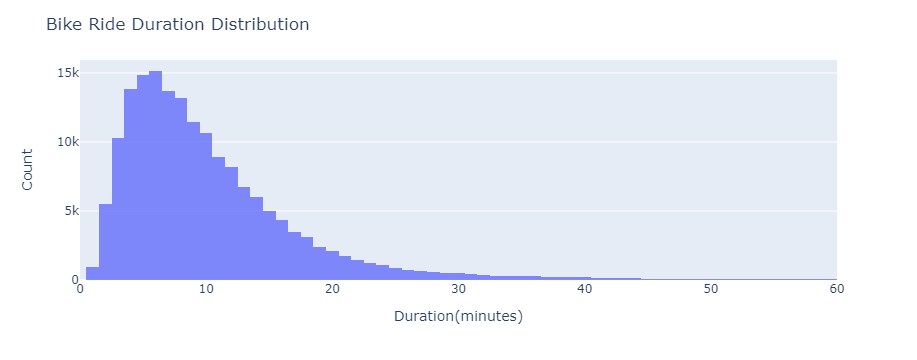

In [27]:
# distribution of bike ride duration
px.histogram(data_frame=ford_bike,x='duration_min',range_x=[0,60],opacity=0.8).update_layout(
    title='Bike Ride Duration Distribution',
    xaxis_title='Duration(minutes)',
    yaxis_title ='Count',
    
)

In [28]:
np.log10(ford_bike['duration_min']).describe()

count    175147.000000
mean          0.929053
std           0.307276
min           0.000000
25%           0.698970
50%           0.903090
75%           1.113943
max           3.148911
Name: duration_min, dtype: float64

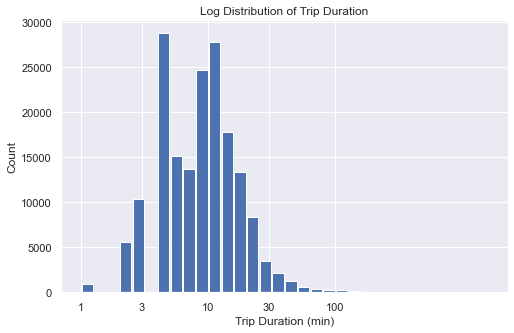

In [29]:
bins = 10 ** np.arange(0, 3.2+0.1, 0.1)
ticks =  [1 , 3, 10, 30, 100]
labels = [f'{v}' for v in ticks]

plt.figure(figsize=[8, 5])
plt.hist(data = ford_bike, x = 'duration_min', bins = bins,rwidth=0.9)
plt.xscale('log')
plt.xticks(ticks, labels)
plt.xlabel('Duration (min)')
plt.ylabel('Count')
plt.title('Log Distribution of Duration');

For bike ride duration, we had to choose a limit of 60 minutes as most of the data lies there. The histogram shows that the data is right skewed with a very long tail.
Most rides take between 6-9 minutes.

After log transformation we see that the duration is bi-modal at about 5 and 10 minutes

The next feature is the age of users.

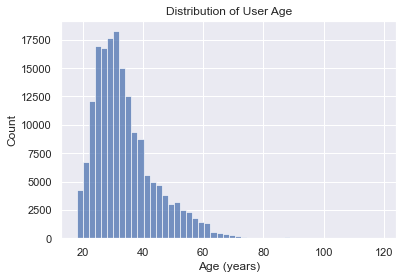

In [30]:
# distribution of user ages
sns.histplot(data=ford_bike,x='age',bins=50)
plt.xlabel('Age (years)')
plt.ylabel('Count')
plt.title('Distribution of User Age');

The age variable is right skewed with most users ages between 24-32 years. 

> __Categorical columns__

In the categorical columns we will start with days of the week

In [31]:
# set the order of days of the week
day_order = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']

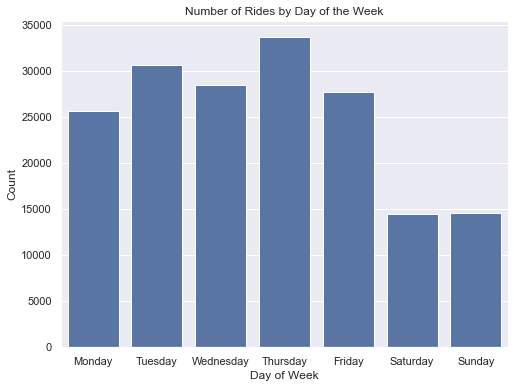

In [32]:
# distribution of days of the week
plt.figure(figsize=(8,6))
base_color = sns.color_palette()[0]
sns.countplot(data=ford_bike,x='day_of_week',color=base_color,order=day_order)
plt.xlabel('Day of Week')
plt.ylabel('Count')
plt.title('Number of Rides by Day of the Week');

Tuesday, Thursday and Wednesday have the most rides respectively. Saturday and Sunday have the least number and this could be because it is the weekend.


Next feature is the days of the month.

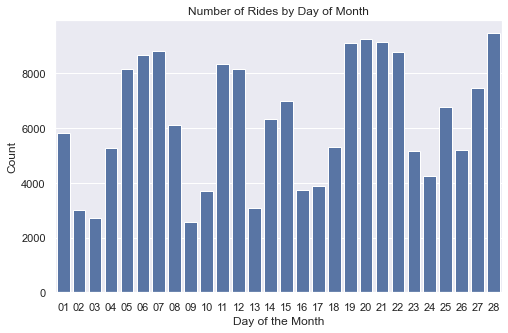

In [33]:
# distribution of rides by days of the month
plt.figure(figsize=(8,5))
sns.countplot(data=ford_bike,x=ford_bike.day.sort_values(ascending=True),color=base_color)
plt.xlabel('Day of the Month')
plt.ylabel('Count')
plt.title('Number of Rides by Day of Month');

> There is a rise in number of bike rides as the week starts and drops during weekends.


The next categorical feature is the user type.

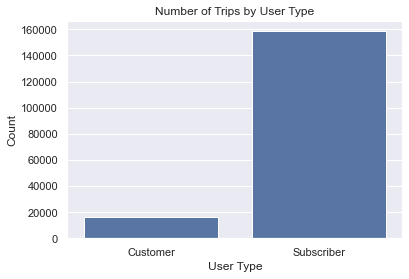

In [34]:
# trips by user type
sns.countplot(data=ford_bike,x=ford_bike['user_type'],color=base_color)
plt.title('Number of Trips by User Type')
plt.xlabel('User Type')
plt.ylabel('Count');


In [35]:
# percentage of users by their user type 
ford_bike.user_type.value_counts(normalize=True)

Subscriber    0.905045
Customer      0.094955
Name: user_type, dtype: float64

> There are more __Subscribers__ (90%) than __Customers__ (10%). This hints at a situation where customers may not see the value of paying for a subscription or do not use the service frequently enough to warrant a subscription.

Next we look at the distribution by gender.

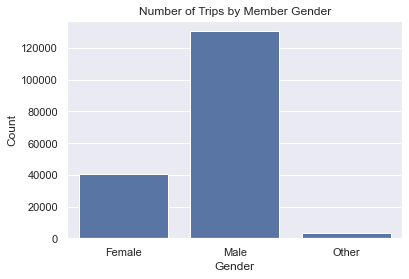

In [36]:
# trips by gender
sns.countplot(data=ford_bike,x='member_gender',color=base_color)
plt.xlabel('Gender')
plt.ylabel('Count')
plt.title('Number of Trips by Member Gender');

In [37]:
# percentage of users by their gender
ford_bike.member_gender.value_counts(normalize=True)

Male      0.745951
Female    0.233198
Other     0.020851
Name: member_gender, dtype: float64

> __Male__ users make up the largest percentage of the users with 74% while __female__ users make up 23%.

Finally, we look at bike share feature.

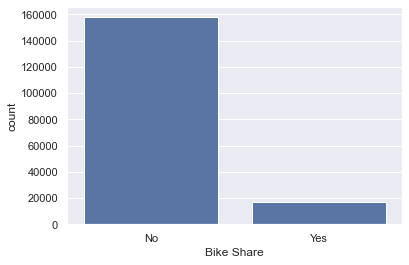

In [38]:
# users enrolled in the bike share program (Yes or No)
sns.countplot(data=ford_bike,x='bike_share_for_all_trip',color=base_color,)
plt.xlabel('Bike Share');

In [39]:
# percentage of users by bike share
ford_bike.bike_share_for_all_trip.value_counts(normalize=True)

No     0.900889
Yes    0.099111
Name: bike_share_for_all_trip, dtype: float64

> Only 9% of users are enrolled in the bike share program.

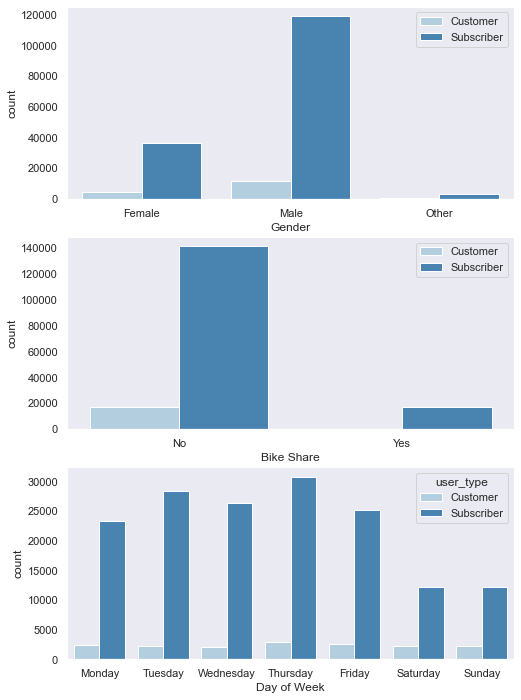

In [84]:
plt.figure(figsize=[8,12])

ax = plt.subplot(3,1,1)
sns.countplot(data=ford_bike,x='member_gender',hue='user_type',palette='Blues')
plt.xlabel('Gender')
ax.legend()

ax =plt.subplot(3,1,2)
sns.countplot(data=ford_bike,x='bike_share_for_all_trip',hue='user_type',palette='Blues',)
ax.legend()
plt.xlabel('Bike Share')


plt.subplot(3,1,3)
sns.countplot(data=ford_bike,x='day_of_week',hue='user_type',palette='Blues',order=day_order)
plt.xlabel('Day of Week');

> The above plot shows how the users are categorized i.e. **Customer** and **Subscriber** in different categorical variables.
>
> A surprising find is that no Customers use bike share. This could be a restriction for only subscribers.

In [41]:
# we can see the percentage of users for bike share by user type
ford_bike.groupby('user_type')['bike_share_for_all_trip'].value_counts(normalize=True) * 100

user_type      
Customer    No     100.000000
            Yes      0.000000
Subscriber  No      89.049055
            Yes     10.950945
Name: bike_share_for_all_trip, dtype: float64

### Distribution of bike duration

> The duration took on a very wide range of values, and therefore  I had to use a limit of 60 minutes initially.
>
> I did a log transformation on the x-axis and found the duration to be bi-modal.

### Distribution of other supporting features.

> There was not much to do as most of them are categorical features.

These are my findings from uni-variate exploration

- Most rides take between 5 and 10 minutes
- There are more users between the age of 21 and 32 years
- Tuesday, Thursday and Wednesday are the busiest days throughout the month.
- Number of rides rises during the start of the week and drops in the weekend.
- 90% of users are subscribers
- 74% of users are male.
- 90% of users do not use bike share.

## Bi-variate Exploration

> In this section, we investigate relationships between pairs of variables in our data.

In [42]:
numerical_cols = ['duration_min','age']

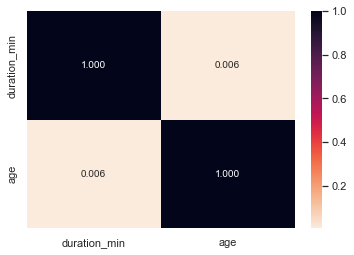

In [43]:
sns.heatmap(ford_bike[numerical_cols].corr(),annot=True,cmap='rocket_r',fmt='.3f');

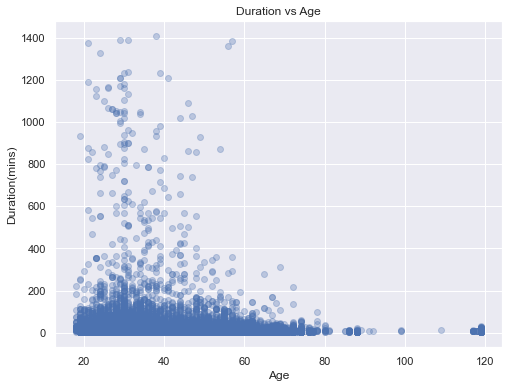

In [44]:
# scatter plot of duration vs age
plt.figure(figsize=(8,6))
plt.scatter(data=ford_bike,y='duration_min',x='age',alpha=0.3)
plt.xlabel('Age')
plt.ylabel('Duration (min)')
plt.title('Duration vs Age');

> The correlation between age and duration is negligible. It has a very weak positive correlation.
>
> There are more users in the lower bike durations.


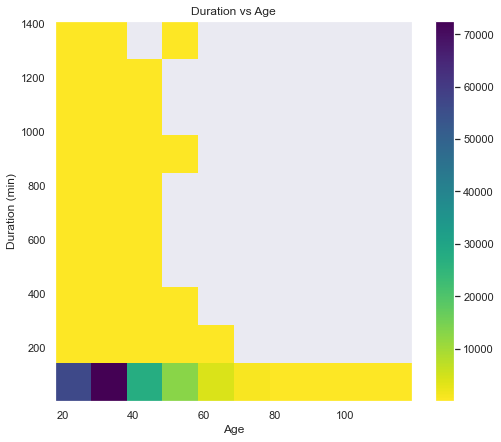

In [45]:
plt.rcParams['axes.grid'] = False
plt.figure(figsize=(8,7))
plt.hist2d(data=ford_bike,x='age',y='duration_min',cmap='viridis_r',cmin=2,)
plt.colorbar()
plt.xlabel('Age')
plt.ylabel('Duration (min)')
plt.title('Duration vs Age');

> There is high concentration of users within the age of 20 and 40 with lower than 100 minutes of bike riding.

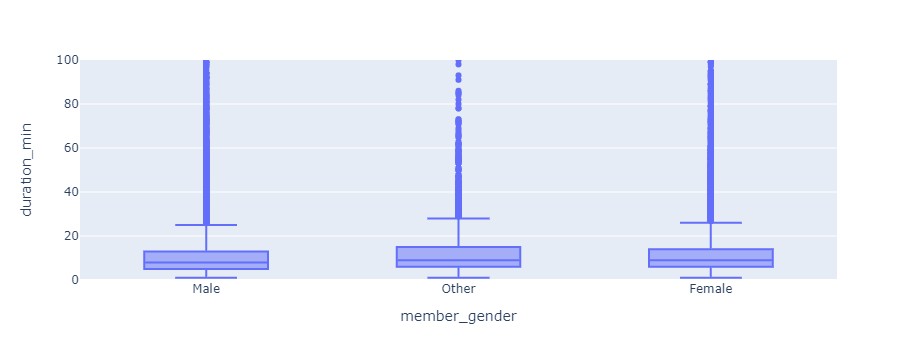

In [46]:
px.box(data_frame=ford_bike,x='member_gender',y='duration_min',range_y=(0,100))

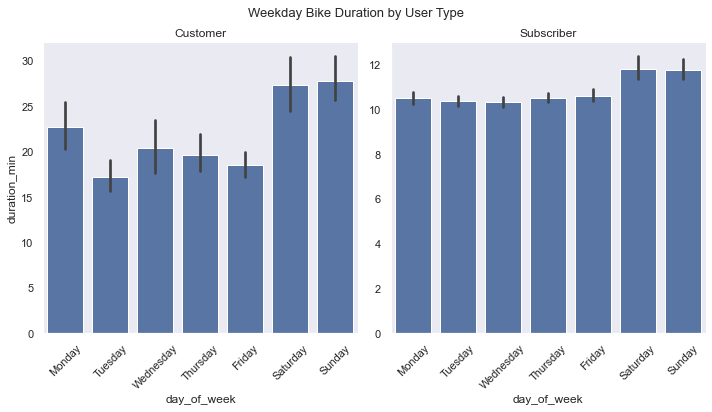

In [47]:
g = sns.catplot(data=ford_bike,x='day_of_week',col='user_type',y='duration_min',kind='bar',sharey=False,color=base_color,order=day_order)
g.fig.suptitle('Average Weekdly Bike Duration by User Type',y=1.03,fontsize=13)
g.set_titles('{col_name}')
g.set_xticklabels(rotation=45);

> We can see that for Subscribers there is no big fluctuation during the week while for Customers there is an inconsistency between the average bike duration.
>
> The average duration for both Subscribers and Customers increases during the weekend. This is the case even though the number of bike rides is lower compared to the weekdays.
>
> For Customers the average time at the end of the weekday is around 18 minutes and increases to 27 minutes, while for Subscribers the average time increases from about 10 minutes to almost 12 minutes which is not a big change.


>

<Figure size 720x2160 with 0 Axes>

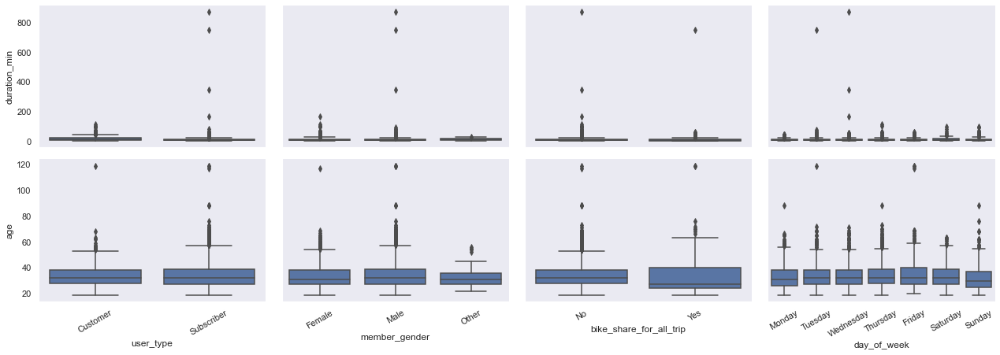

In [190]:
sample = np.random.choice(ford_bike.shape[0],3000,replace=False)
sample_df =ford_bike.iloc[sample,:] # creates a sample of the data since it has a lot of values
def boxgrid(x, y,**kwargs):
    sns.boxplot(x, y, color = base_color)
    plt.xticks(rotation = 30)
plt.figure(figsize=(10,30))
s = sns.PairGrid(data=sample_df,y_vars=['duration_min','age'],
                 x_vars=['user_type','member_gender','bike_share_for_all_trip','day_of_week'],aspect=1.5,size=3)
s.map(boxgrid);

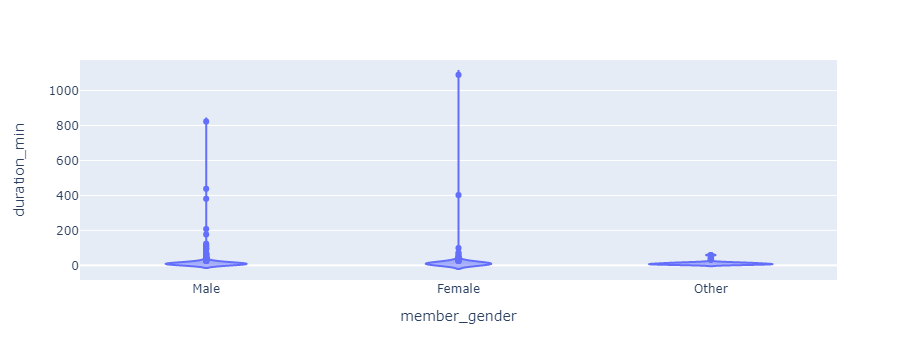

In [49]:
px.violin(data_frame=sample_df,x='member_gender',y='duration_min',)

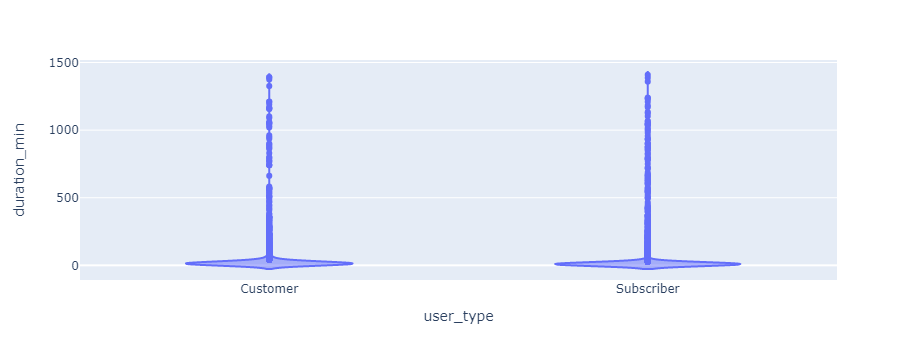

In [50]:
px.violin(data_frame=ford_bike,x='user_type',y='duration_min')

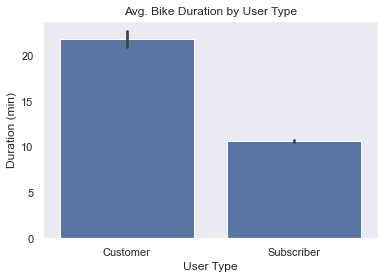

In [51]:
sns.barplot(data=ford_bike,x='user_type',y='duration_min',color=base_color)
plt.xlabel('User Type')
plt.ylabel('Duration (min)')
plt.title('Avg. Bike Duration by User Type');

> Customers tend to ride bikes for longer durations than Subscribers on average; by more than double the average time by Subscribers.

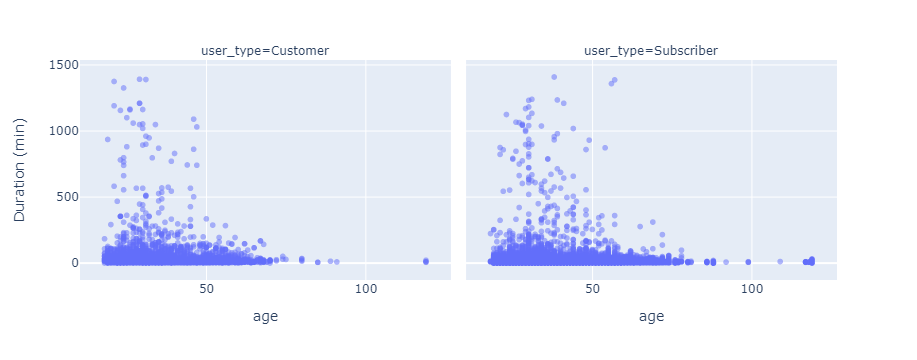

In [64]:
px.scatter(data_frame=ford_bike,x='age',y='duration_min',opacity=0.5,facet_col='user_type').update_layout(yaxis_title='Duration (min)')

> We can see that more users lie around the lower end of the duration between 0 and 200 minutes. There is a wide spread of users between the lower end of the bike durations to the higher end.
>
> Faceting by user type enables us to see a preview of how the data is distributed between Customers and Subscribers.

### Relationships between the main feature and supporting variables.

> Most bike rides are located on the lower end of bike durations and a very small number of users take long bike rides.
>
> Earlier in the uni-variate exploration we found out that the number of rides in the weekend drops in comparison to the number of rides during the weekday, but interestingly the **average**  duration of bike rides while taking into account the number of rides, is higher than the average during the weekday.
>
> Customers take longer rides on average in comparison to the Subscribers. This shows that customers tend to use the bike service for leisure while subscribers tend to use the service for work or exercise.
>

### Relationship between other features

> A very interesting find is that Customers are not part of the bike share program. The bike share program seems to be exclusively for the Subscribers of the service.

## Multivariate Exploration
>
>
> We will start with duration vs age categorized by user type

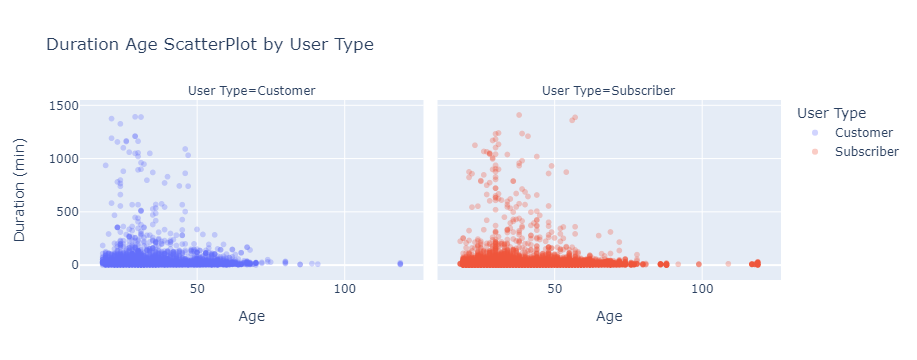

In [67]:
px.scatter(x='age',data_frame=ford_bike,y='duration_min',color='user_type',
           symbol='user_type' ,symbol_sequence=['0', '0'],opacity=0.3,facet_col='user_type',
           title='Duration Age ScatterPlot by User Type',
           labels={'user_type':'User Type',
                   'age':'Age',
                   'duration_min':'Duration (min)'})

> Here we plotted a scatter plot of the duration vs. age of users and added color to differentiate between the Customers and Subscribers.
> A faceted plot allows us to see clearly the distribution, since the dataset is made up of many points that would be hard to differentiate even with separate colors for the user types.

> Next we make a box plot of duration vs user type categorized by gender.

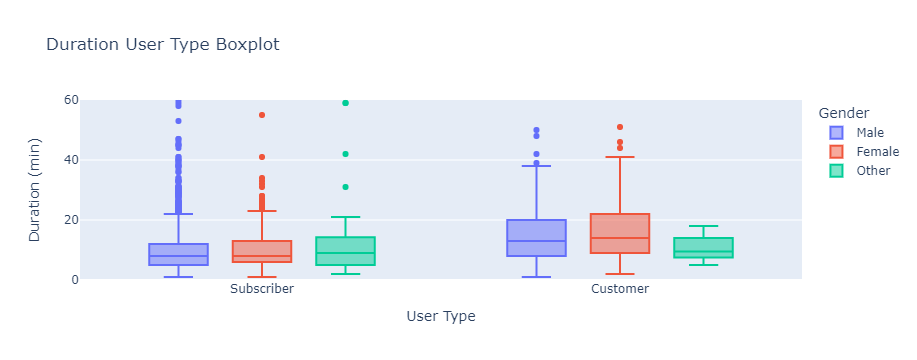

In [57]:
px.box(data_frame=sample_df,x='user_type',y='duration_min',color='member_gender',range_y=[0,60],
       labels={'duration_min':'Duration (min)',
               'user_type':'User Type',
               'member_gender': 'Gender'},
       title='Duration User Type Boxplot'
)

> We used a range of 60 minutes for the bike duration.
>
> From the box plot we can see that male and female customer rides are more spread between the upper fence of the box plot and the  minimum duration.
>
> For Subscribers, the spread is tighter between the male and female subscribers.
>
> The only difference is between the **Other** gender but their count in the dataset is too small compared to male and female users.


> We then make a box plot of duration vs bike share categorized by user type.

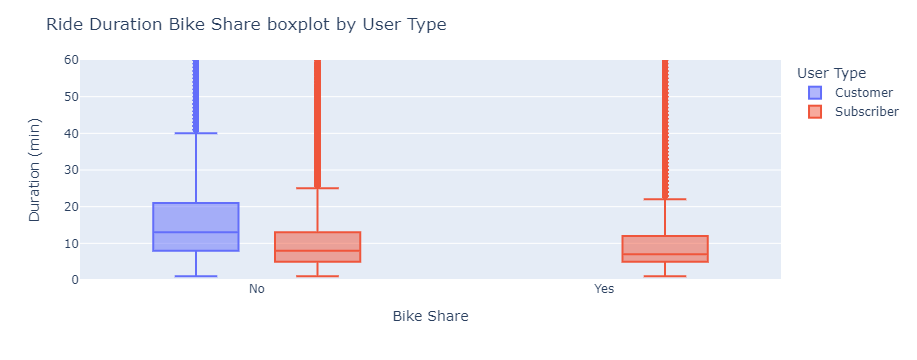

In [185]:
px.box(data_frame=ford_bike,x='bike_share_for_all_trip',y='duration_min',color='user_type',range_y=[0,60],
       labels={'user_type':'User Type',
               'duration_min':'Duration (min)',
               'bike_share_for_all_trip':'Bike Share'}).update_layout(
    title='Ride Duration Bike Share boxplot by User Type'
)

> We used a range of 60 minutes for this plot too.
>
> **Subscribers** use bike share whereas **Customers** do not as seen earlier in the analysis.
>
> Customer rides are widespread between the minimum duration and the upper fence while it's the opposite for Subscribers.


In [133]:
cat_type = pd.CategoricalDtype(
    categories=day_order,
    ordered=True
)
ford_bike['day_of_week'] = ford_bike['day_of_week'].astype(cat_type)


In [186]:
# average duration of bike rides during the week
week_df_avg =ford_bike.groupby(['user_type','day_of_week'])['duration_min'].mean().reset_index()
# total duration of bike rides during the week
week_df_size =ford_bike.groupby(['user_type','day_of_week'])['duration_min'].size().reset_index()


> We make a plot of the average daily bike duration during the week categorized by user type.

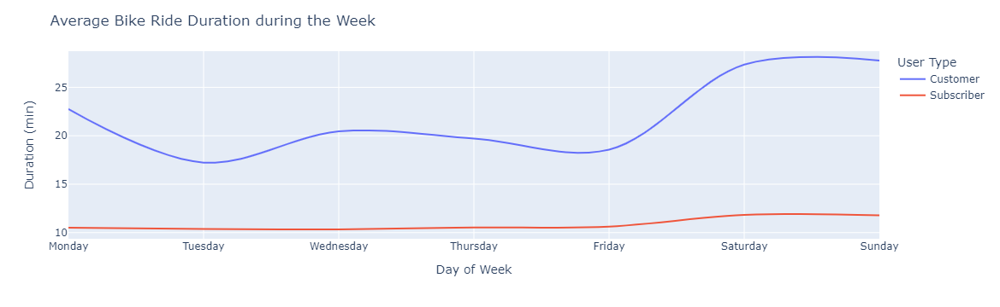

In [182]:
px.line(week_df_avg,x='day_of_week',y='duration_min',color='user_type',line_shape='spline',
        labels = {'user_type':'User Type',                                                                                                  'duration_min':'Duration (min)',                                                                                                 'day_of_week':'Day of Week'}
        ).update_layout(
    title ='Average Bike Ride Duration during the Week'
)

> The average bike ride duration plot shows that Customers spend more time riding than Subscribers. There is also a spike in the duration as the weekend approaches for customers compared to subscribers which sees only a small increase.

> Finally, we plot daily total bike duration during the week categorized by the user type.

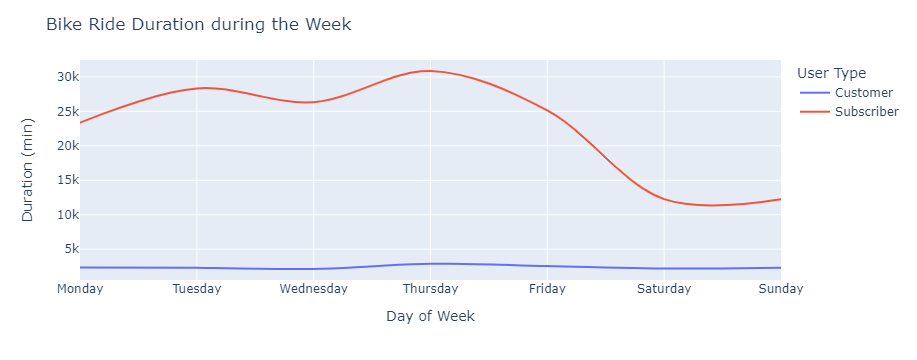

In [188]:
px.line(week_df_size,x='day_of_week',y='duration_min',color='user_type',line_shape='spline',
        labels = {'user_type':'User Type',
                  'duration_min':'Duration (min)',
                  'day_of_week':'Day of Week'}
        ).update_layout(
    title ='Bike Ride Duration during the Week'
)

> The total bike duration plot shows that there are far fewer customers than subscribers since there is a very big difference between the total minutes by each category; for example Thursday has 2875 total minutes for customers while the number of minutes spent on rides for subscribers stands at over 30,000 minutes.

### Relationships between main feature and other variables

> When we use the average duration in minutes, we find that **Customers** spend more time on rides than **Subscribers**.
>
> Customer rides are widespread between the minimum duration and the upper fence while Subscriber rides are less spread.
>
> The variable that gave us more insight to the data in this section is the <code>day_of_week</code> variable, as we could see how durations change during the week.

### Were there any interesting or surprising interactions between features?

> A surprising find is that the average duration increases during the weekend but the number of rides taken decreases, which could be due to the fewer number of data points and users riding for leisure.

## Conclusions
>You can write a summary of the main findings and reflect on the steps taken during the data exploration.
> During the analysis we chose duration of rides as the main feature for our analysis.
>
> We cleaned the data and came up with new features from existing ones to help with analysis. The <code>start_time</code> feature helped in this process as we came up with two new features namely:
>  - day_of_week
>  - day
>
> We then began with the Uni-variate exploration, followed by the Bi-variate exploration and finally the Multi-variate exploration of the data. In this section we made different plots for different variables.
> The data was only from February 2019, and it would have been great if there was data for the whole year. We could have seen trends during the different seasons of the year if any.

In [187]:
# export the final dataset for storage
# ford_bike.to_csv('data/fordgobike-final.csv',index=False)